In [1]:
import pandas as pd
import networkx as nx
import numpy as np
from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt
from heat_kernel_func import *
%load_ext autoreload
%autoreload 2

In [2]:
lu5 = pd.read_csv('lu5_utm.csv')

In [3]:
m = Basemap(
        projection='merc',
        llcrnrlon=-74.1,
        llcrnrlat=40.55,
        urcrnrlon=-73.65,
        urcrnrlat=40.92,
        lat_ts=0,
        resolution='h',
        suppress_ticks=True)

In [4]:
def k_neighbors(points, weighted=True, k=3):
    '''
    weights are 1 / distance
    returns a weighted edgelist
    '''
    num_points = points.shape[0]
    
    # expanded out form of distance formula
    squared = (points ** 2).sum(axis=1, keepdims=True)
    mixed = points @ points.T
    dists = np.sqrt(squared + squared.T - (2 * mixed))

    closest_idx = np.argsort(dists, axis=1)[:, 1:(k + 1)]
    
    edge_list = []
    for i in range(num_points): # this can probably be parallelized
        cdists = dists[i, closest_idx[i]]
        if weighted:
            edge_list.extend([(i, j, 1 / cdists[k]) 
                              for k, j in enumerate(closest_idx[i])])
        else:
            edge_list.extend([(i, j, 1) 
                              for k, j in enumerate(closest_idx[i])])

    
    del dists
    del closest_idx
    
    return edge_list

In [5]:
weighted_edge_list = k_neighbors(lu5.loc[lu5.BoroCode != 5, ['utm18_x', 'utm18_y']].as_matrix(), k=28)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in sqrt
  if sys.path[0] == '':


In [6]:
weighted_G = nx.Graph()
weighted_G.add_weighted_edges_from(weighted_edge_list)

/usr/local/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


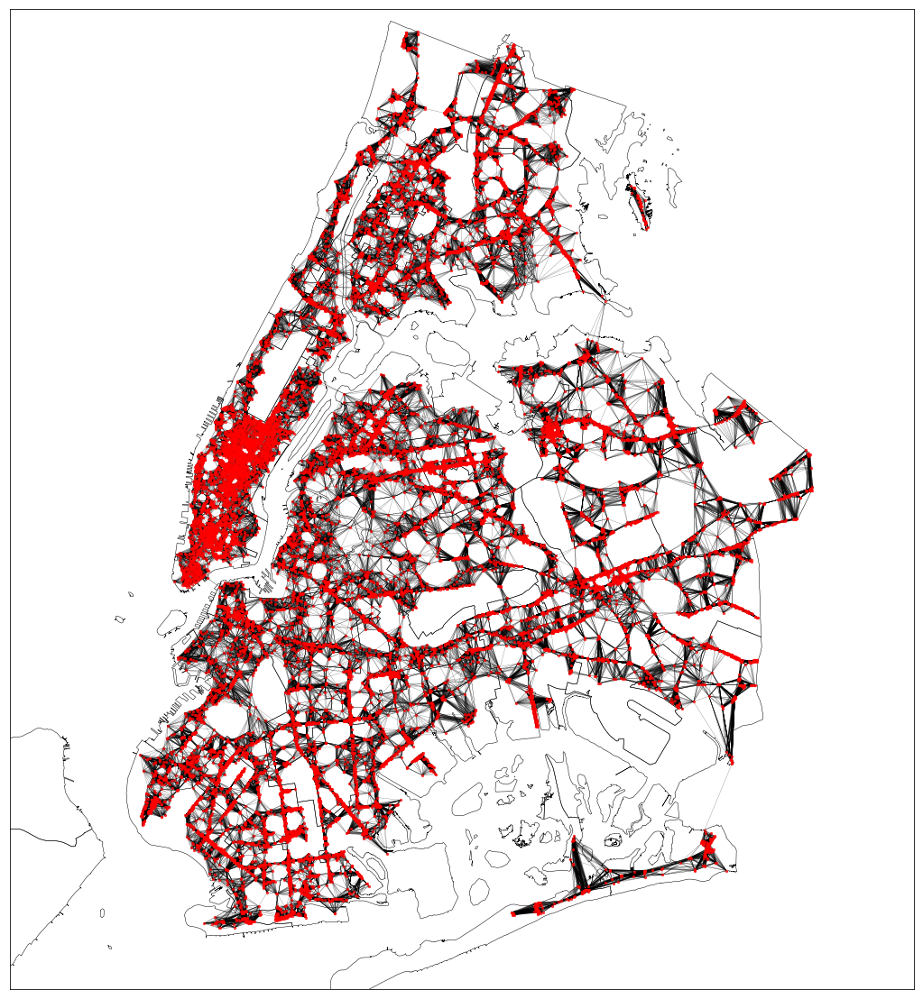

In [7]:
plt.figure(figsize=(20, 20))

m.readshapefile('../pluto/shapefiles/nycc', 'nyc-council')
positions = {i: m(pair[1], pair[2]) 
             for i, pair in enumerate(lu5[['lon', 'lat']].itertuples())}

nx.draw_networkx(weighted_G, positions, node_size=5, with_labels=False, alpha=.7, width=.25)

In [9]:
weighted_hks_dict = {}
ts = [.01, .1, .5, 1, 5, 10, 50, 100]
# for t in ts:
#     weighted_hks_dict[t] = hks_s(weighted_G, t, list(weighted_G.nodes()), k=3000)
#     print('done with time %s' % t)
weighted_hks_dict = hks_s(weighted_G, ts, list(weighted_G.nodes()), verbose=True, k=10000,
                          eigen_save_loc='eigen_saves/weigted_pluto_knn')


Loading eigen values/vectors from file...
done! (3.08s)
Done with time 0.01...
Done with time 0.1...
Done with time 0.5...
Done with time 1...
Done with time 5...
Done with time 10...
Done with time 50...
Done with time 100...
Finished in 76.19 seconds


In [10]:
import heapq, itertools
lnode = heapq.nlargest(10, weighted_hks_dict[1e-2], key=weighted_hks_dict[1e-2].get)
for node in lnode:
    print(node)
    print(nx.degree(weighted_G, node))
#     plt.figure(figsize=(7, 7))
#     m.readshapefile('../shapefiles/nycc', 'nyc-council')
#     neighbs = nx.neighbors(weighted_G, node)
# #     print(node, [x for x in neighbs])
#     plt.scatter(*zip(*[positions[node] for node in neighbs]))
#     plt.scatter(*positions[node])

# plt.scatter(*zip(*[positions[node] for node in lnode])) 

16493
43
12043
40
14827
43
16488
36
12020
36
14949
47
16699
45
4246
53
14948
49
14616
54


(array([7.529e+03, 4.564e+03, 4.080e+03, 1.884e+03, 9.960e+02, 6.370e+02,
        1.760e+02, 9.800e+01, 1.600e+01, 2.000e+00]),
 array([28. , 31.4, 34.8, 38.2, 41.6, 45. , 48.4, 51.8, 55.2, 58.6, 62. ]),
 <a list of 10 Patch objects>)

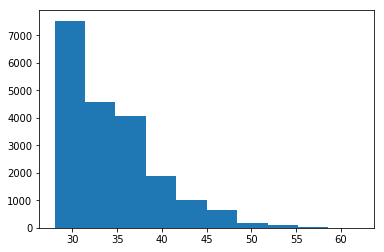

In [11]:
plt.hist([nx.degree(weighted_G, node) for node in weighted_G.nodes()])

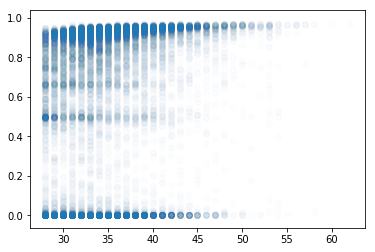

In [12]:
plt.scatter(*zip(*[(nx.degree(weighted_G, node), hks) 
                   for node, hks in weighted_hks_dict[.01].items()]), alpha=.01)

0.9745313406466694 0.4981767652539592 4.5977029515206045e-12
0.935507010317031 0.47827251489674044 4.403521442772262e-12
0.8326899760864088 0.40068885753514827 3.644895087645078e-12
0.7323908932831186 0.32390737354460836 2.895685031287257e-12
0.2747097116331649 0.0725947464279469 5.817655563557037e-13
0.08173967125910106 0.014367499361633167 1.1949544806942214e-13
5.147947134060901e-06 2.6640465760045145e-07 7.424136117795694e-19
3.1674067764120984e-11 9.069265356319088e-13 2.2588106424854062e-24


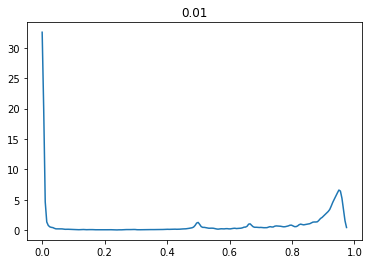

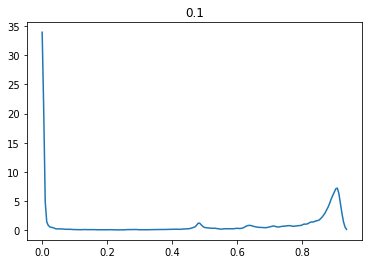

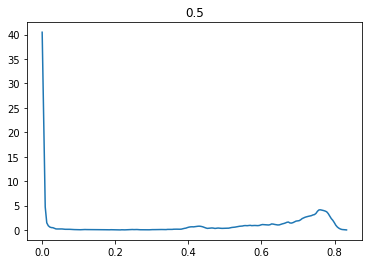

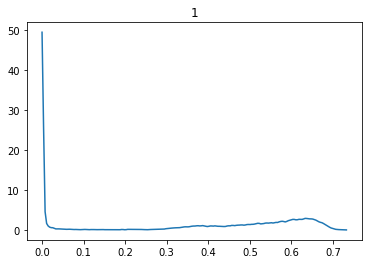

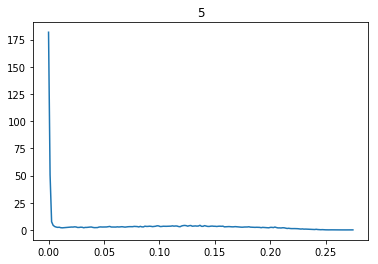

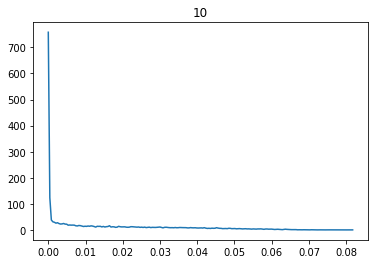

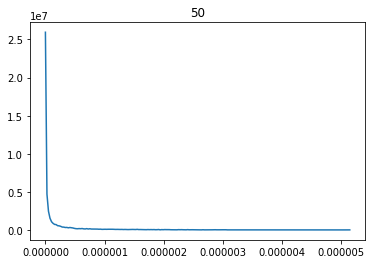

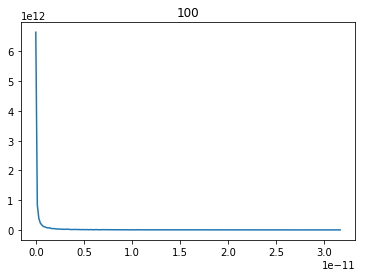

In [13]:
from scipy.stats import gaussian_kde
for t in ts:
    v = weighted_hks_dict[t]
    plt.figure()
    ax = plt.axes()
    density = gaussian_kde(list(v.values()))
    xs = np.linspace(max(v.values()), min(v.values()),200)
    density.covariance_factor = lambda : .01
    density._compute_covariance()
    plt.plot(xs, density(xs))
    plt.title(t)
    print(max(v.values()), np.mean(list(v.values())), min(v.values()))

In [10]:
def compare_to_node_s(G, positions, hks_dict, node, ts=[1e-6]):
    plt.figure(figsize=(10, 10))
    m.readshapefile('../pluto/shapefiles/nycc', 'nyc-council')
    plt.scatter(*positions[node])
    
    for t in ts:
        node_hks = hks_dict[t][node]
        colors = np.array([abs(other_hks - node_hks) for i, other_hks in hks_dict[t].items()])
        log_colors = np.log(colors + 1)
        plt.figure()
        print(min(colors), np.mean(colors), max(colors))
        print(min(log_colors), np.mean(log_colors), max(log_colors))
        print()

        plt.hist(np.sort(colors))
        cmap = matplotlib.cm.viridis_r
        plt.figure(figsize=(20, 20))
        plt.title(t)
        m.readshapefile('../pluto/shapefiles/nycc', 'nyc-council')
        positions = {i: m(pair[1], pair[2]) 
                     for i, pair in enumerate(lu5[['lon', 'lat']].itertuples())}
        nx.draw(G, positions, node_color=log_colors, cmap=cmap, node_size=5, 
                with_labels=False, alpha=.7, width=.25)

0.0 0.49812225135779686 0.9744565071316539
0.0 0.36123433720191855 0.6802931742199442

0.0 0.4782193378695536 0.9354340007700116
0.0 0.35045448410904784 0.660331591136171

0.0 0.4006412321419874 0.8326245455147322
0.0 0.30603012122838186 0.6057491172793886

0.0 0.3238658716365166 0.7323338308980474
0.0 0.25805334364839483 0.5494695345804248

0.0 0.0725808509704411 0.27469050418120367
0.0 0.06778612740351168 0.2427034073251617

0.0 0.014363906584751066 0.0817346809028412
0.0 0.014115478567852722 0.07856593862007942

0.0 2.6630329154398634e-07 5.147802687631054e-06
0.0 2.66303088064157e-07 5.147789437786444e-06

0.0 9.066131121349161e-13 3.167360762459063e-11
0.0 9.066132557559377e-13 3.1673552669029483e-11



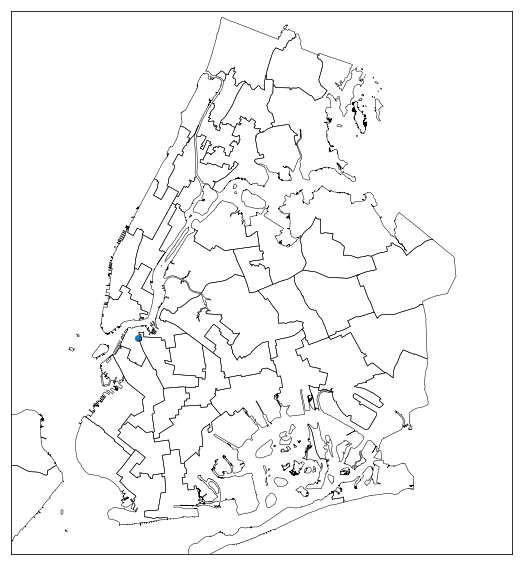

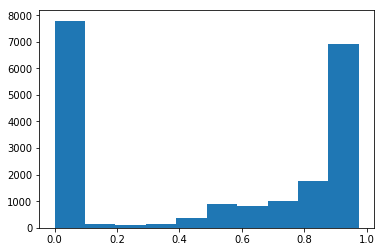

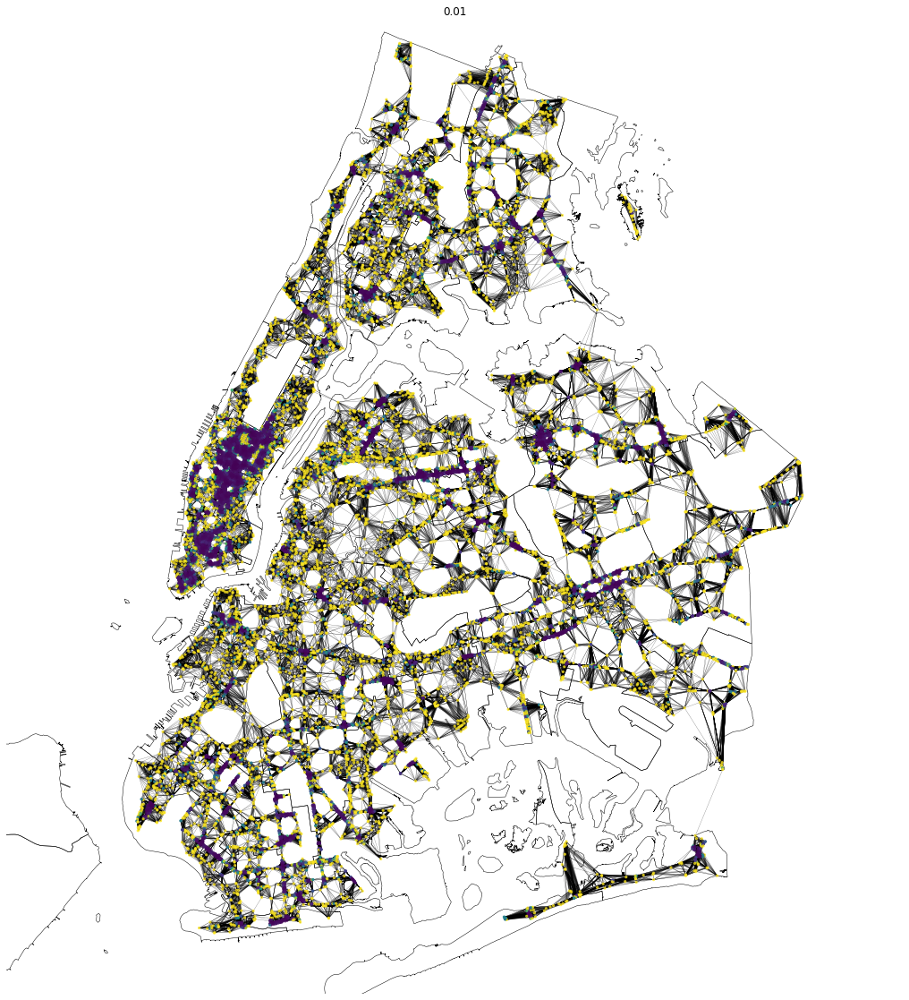

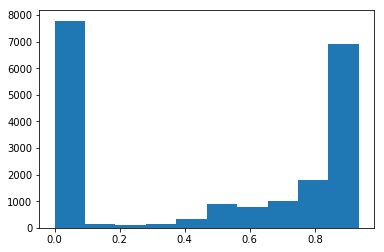

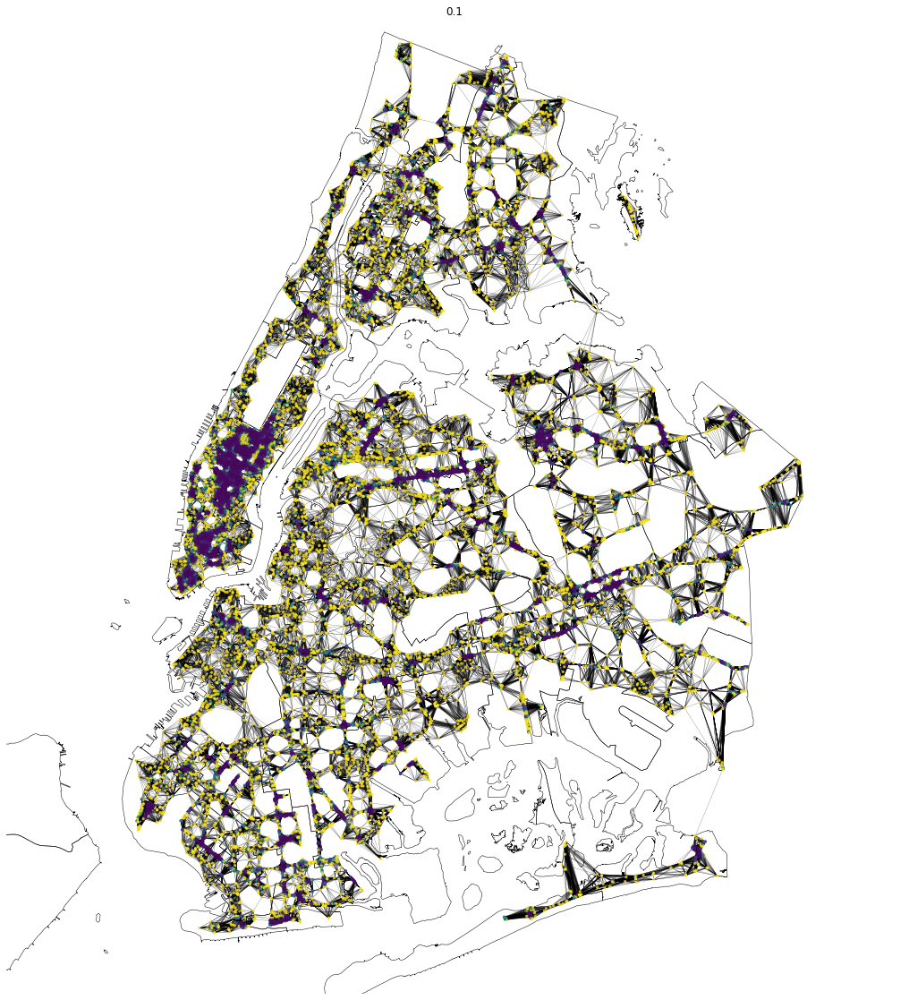

...

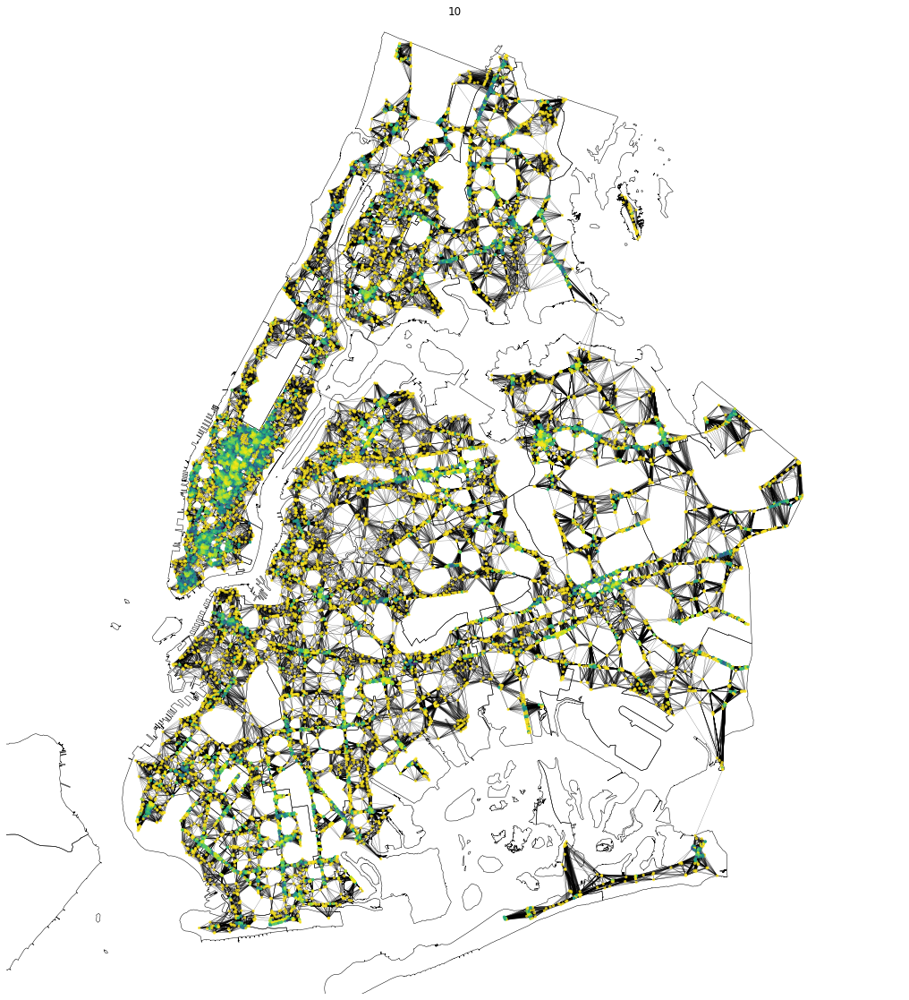

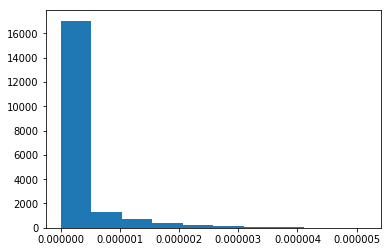

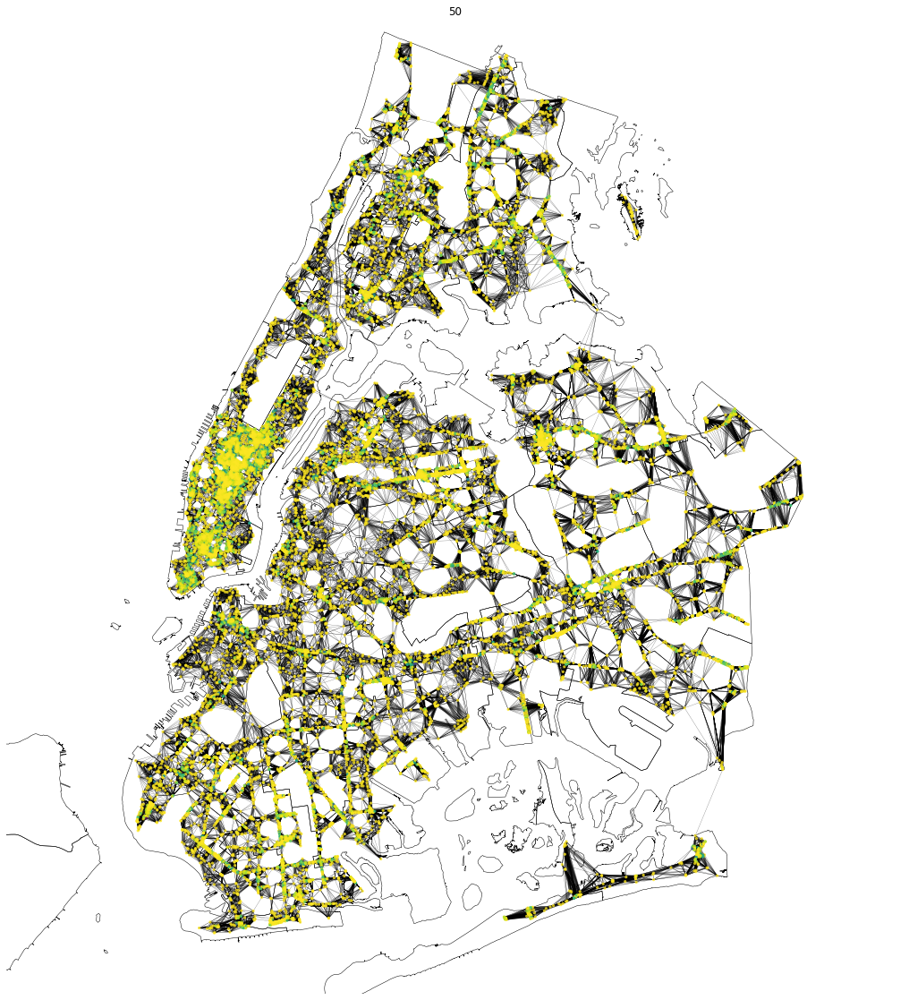

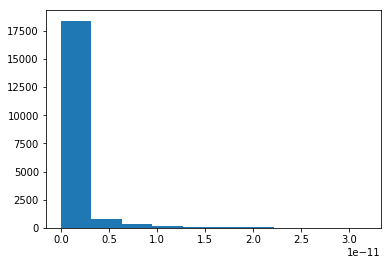

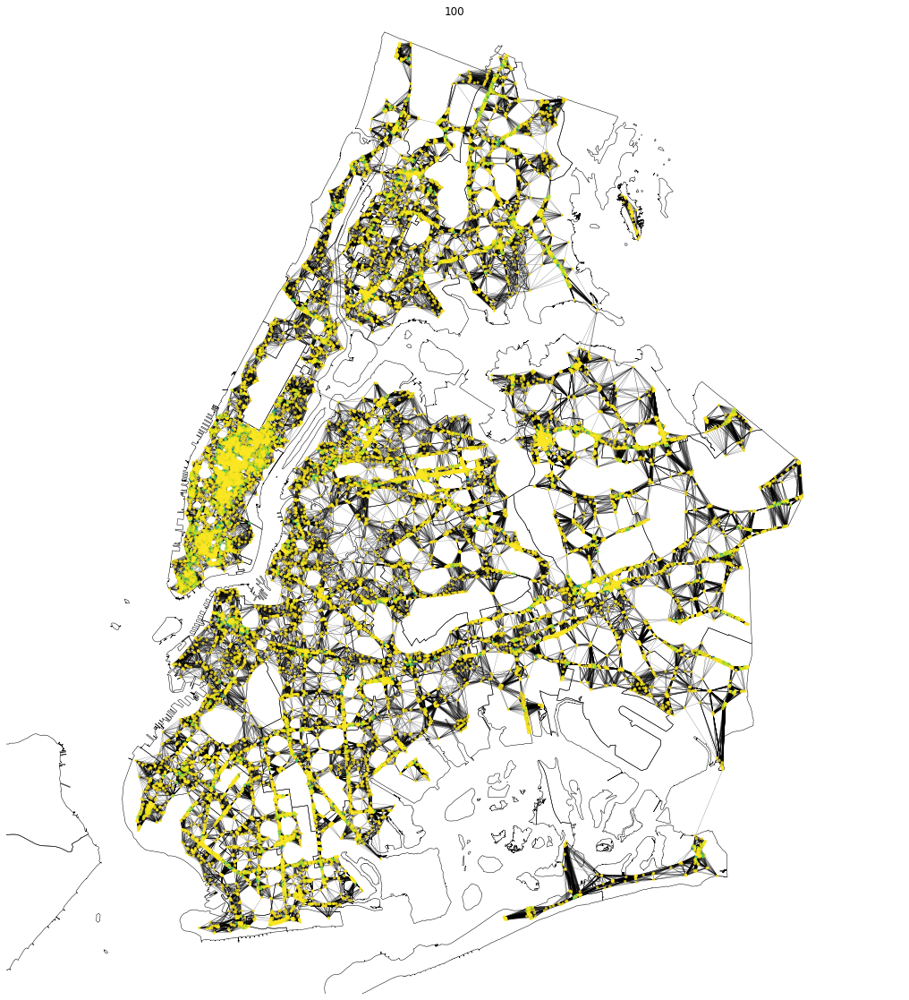

In [11]:
compare_to_node_s(weighted_G, positions, weighted_hks_dict, 26, ts)

0.0 0.46373486951688203 0.9617160602116238
0.0 0.33937605636814056 0.6738196311043435

0.0 0.3982720896219794 0.8413658276869381
0.0 0.3009427661846292 0.6105075939101948

0.0 0.311319688474461 0.46656946796602816
0.0 0.26486530771497013 0.38292597821868585

0.0 0.2742637618619219 0.5064290607101567
0.0 0.23946256999213963 0.40974198967111364

0.0 0.07194176948389795 0.27281197655484046
0.0 0.06726467067569178 0.24122860760970957

0.0 0.014305643638262354 0.08159318297363773
0.0 0.014059168813429104 0.07843512356262289

0.0 2.65648070708782e-07 5.146386309427128e-06
0.0 2.656478676054839e-07 5.146373066728699e-06

0.0 9.052705674280738e-13 3.167080757573748e-11
0.0 9.05276921049751e-13 3.167088813377047e-11



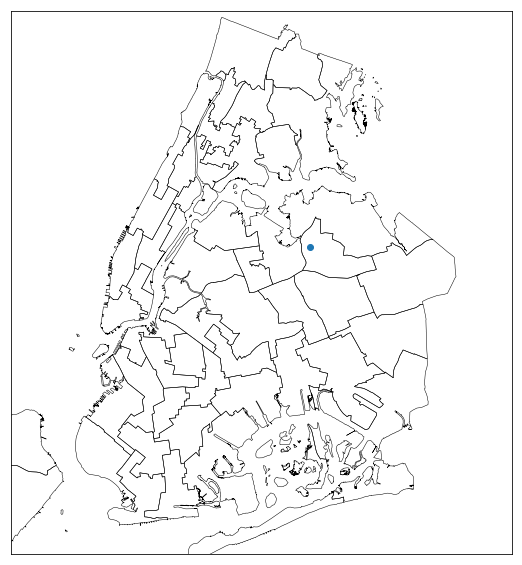

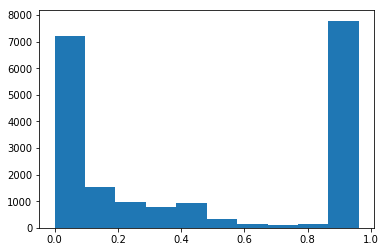

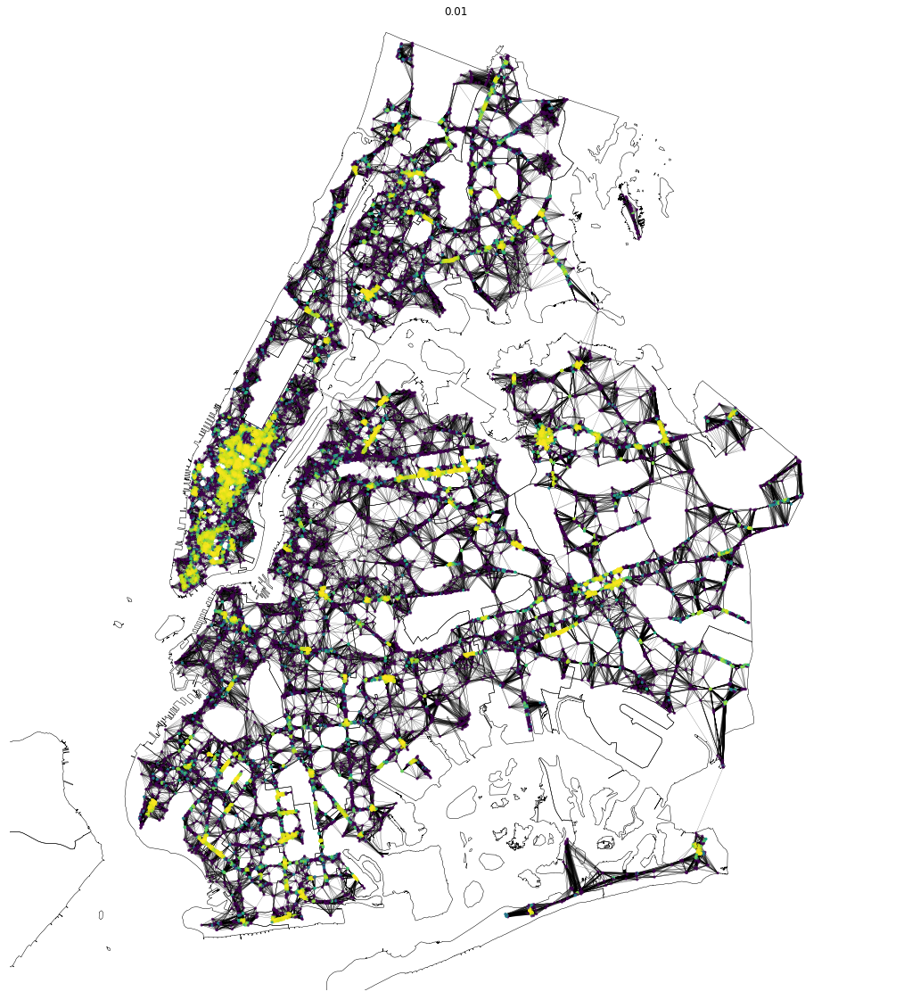

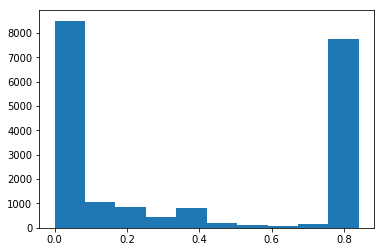

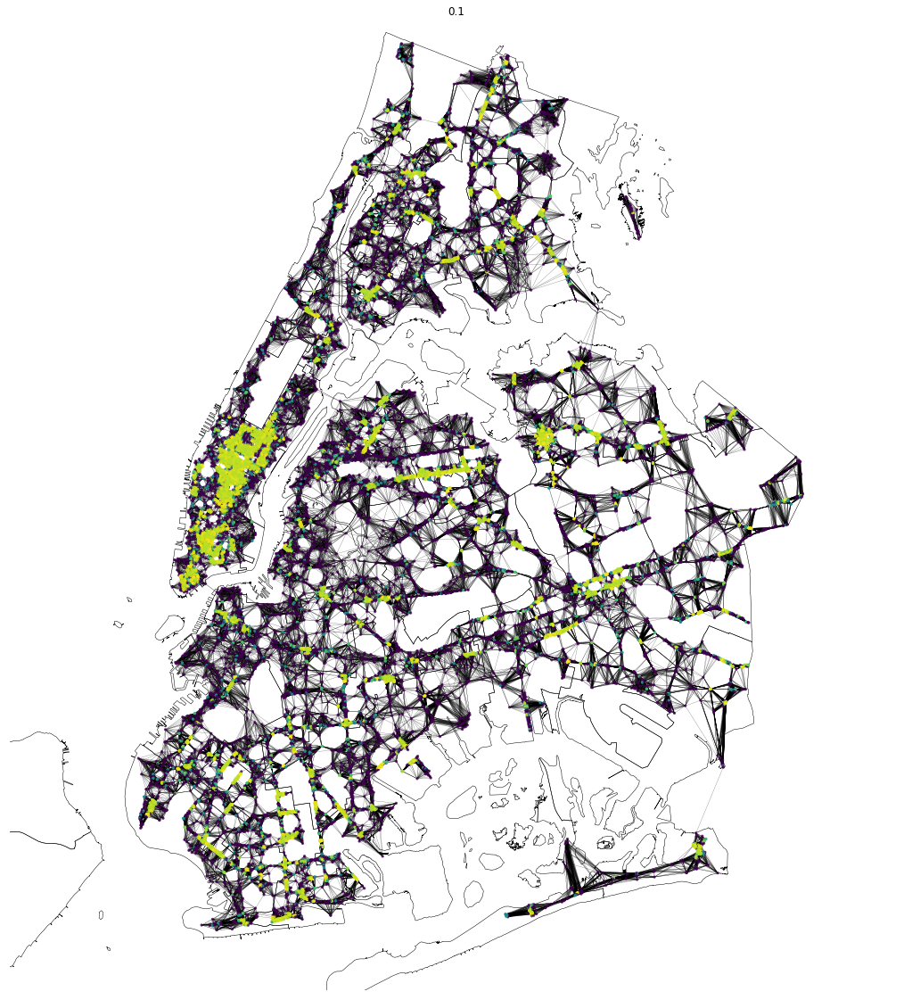

...

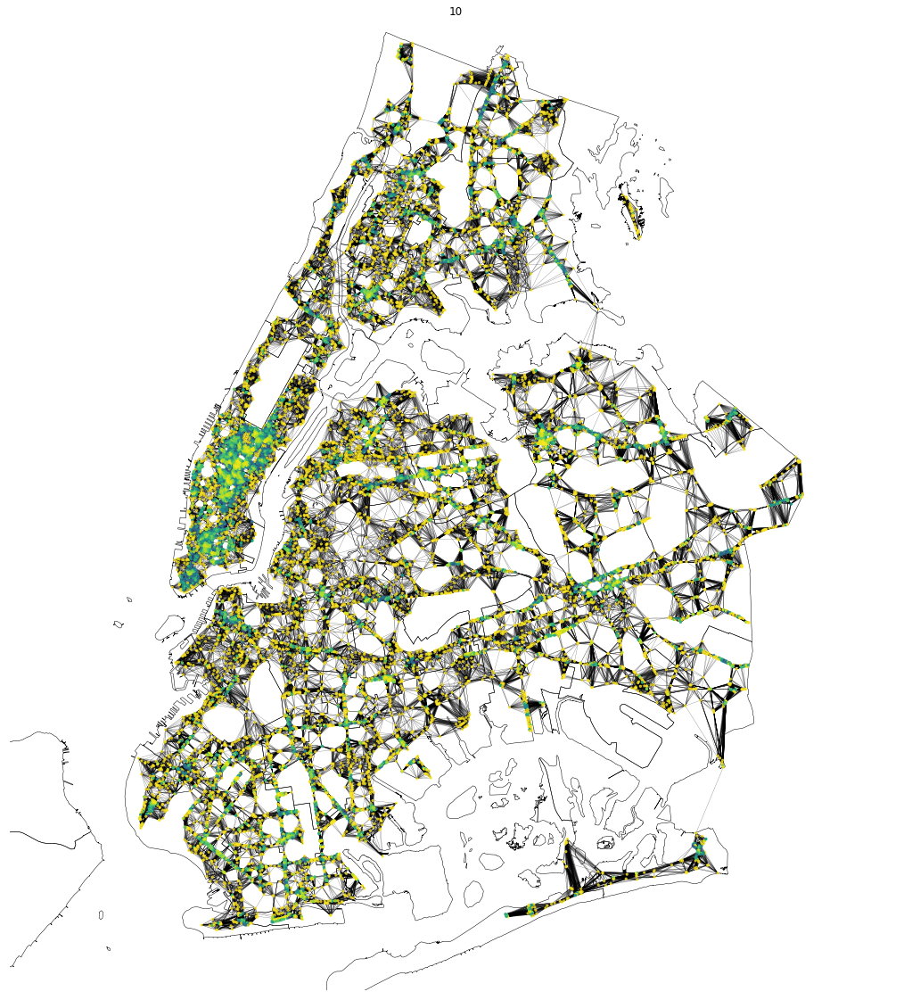

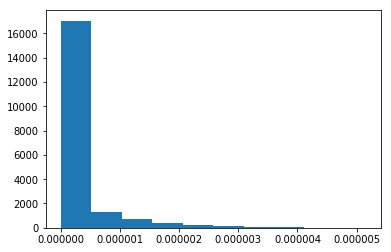

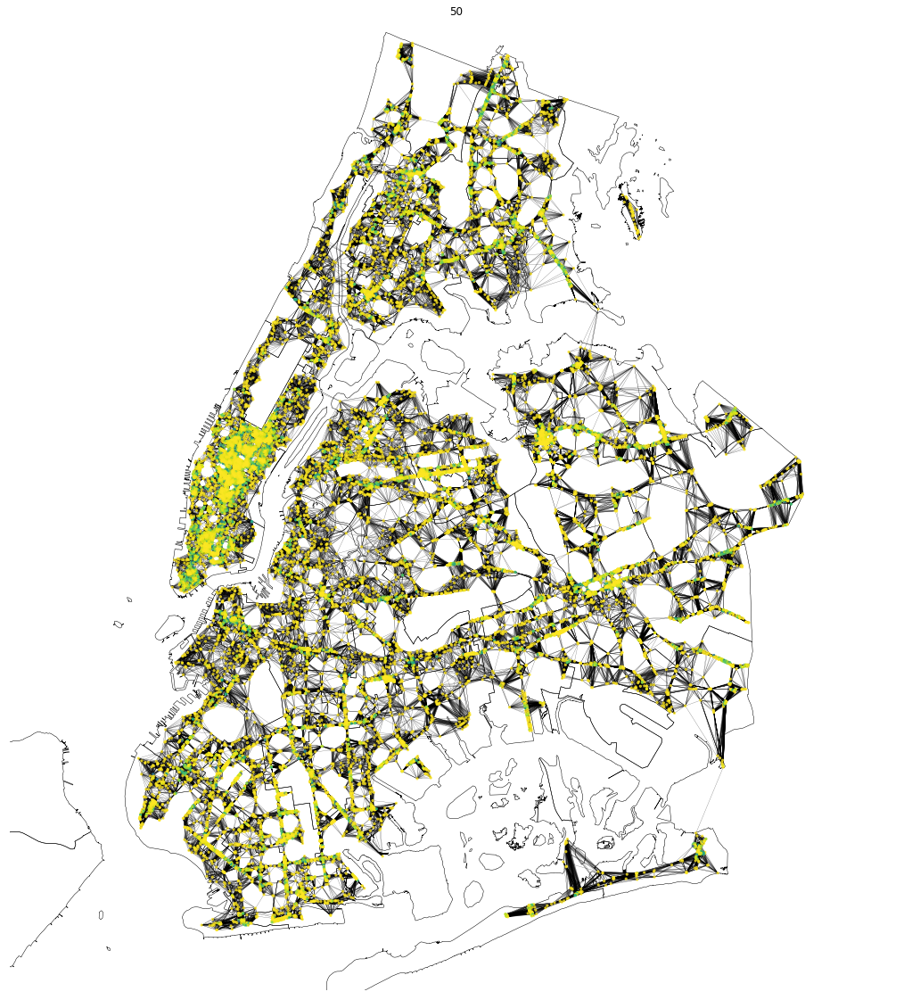

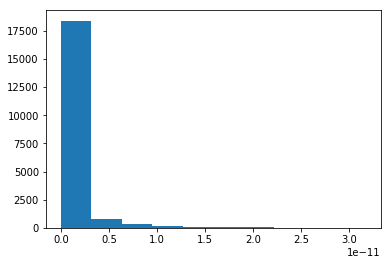

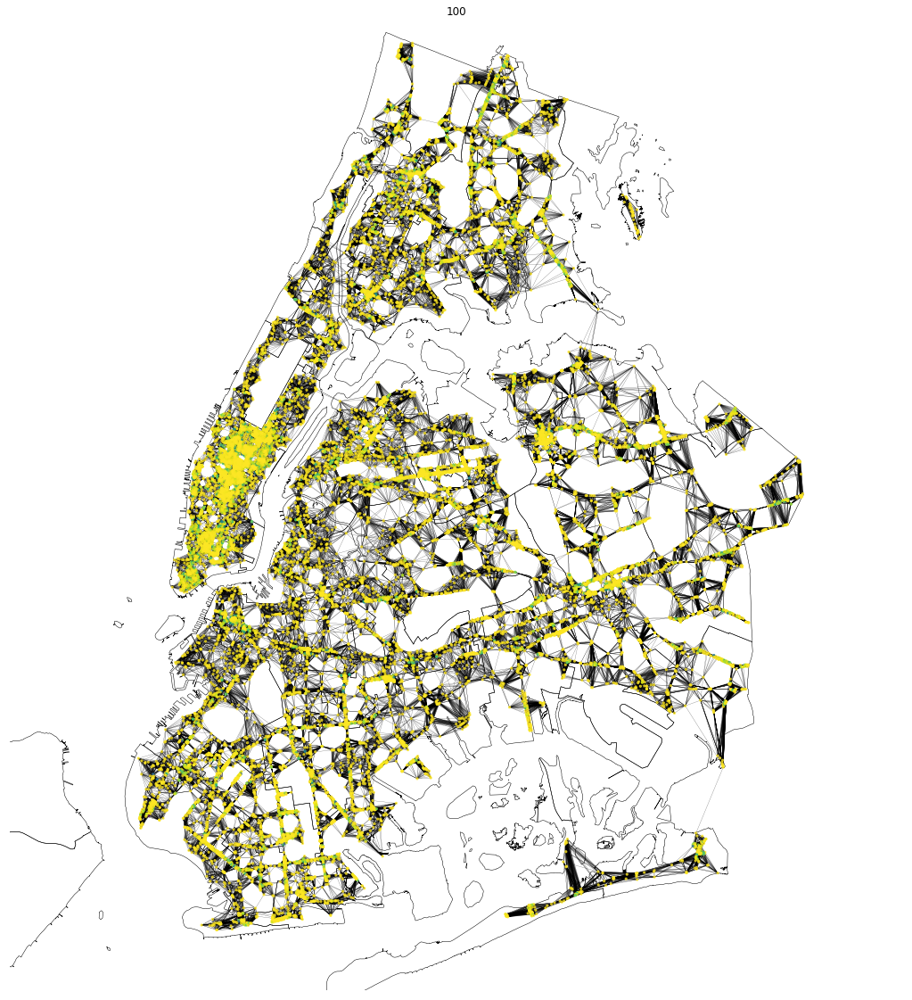

In [18]:
compare_to_node_s(weighted_G, positions, weighted_hks_dict, 16673, ts)

In [39]:
unweighted_edge_list = k_neighbors(lu5.loc[lu5.BoroCode != 5, ['utm18_x', 'utm18_y']].as_matrix(),
                                   weighted=False, k=28)
unweighted_G = nx.Graph()
unweighted_G.add_weighted_edges_from(unweighted_edge_list)
unweighted_hks_dict = {}
ts = [.01, .1, 1, 5, 10]
unweighted_hks_dict = hks_s(unweighted_G, ts, list(unweighted_G.nodes()), verbose=True, eigen_save_loc='eigen_saves/unweigted_pluto_knn')
print('done with time %s' % t)

/home/ubuntu/anaconda3/envs/mainEnv/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  """Entry point for launching an IPython kernel.
/home/ubuntu/anaconda3/envs/mainEnv/lib/python3.6/site-packages/ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in sqrt
  if sys.path[0] == '':


Loading eigen values/vectors from file... done! (0.02s)
Done with time 0.01...
Done with time 0.1...
Done with time 1...
Done with time 5...
Done with time 10...
Finished in 2.00 seconds
done with time 10


0.0 0.009158140051919055 0.5807221059399054
0.0 0.007638212416200435 0.4578817717087867



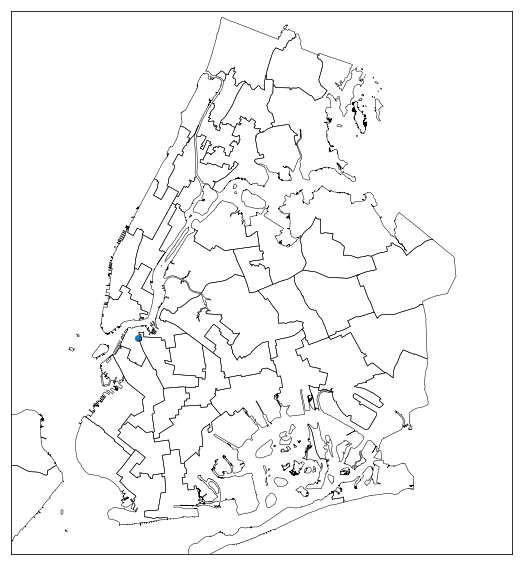

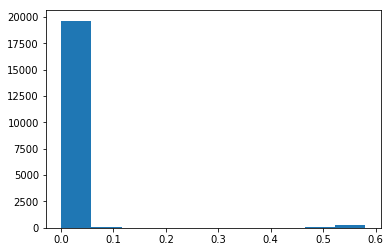

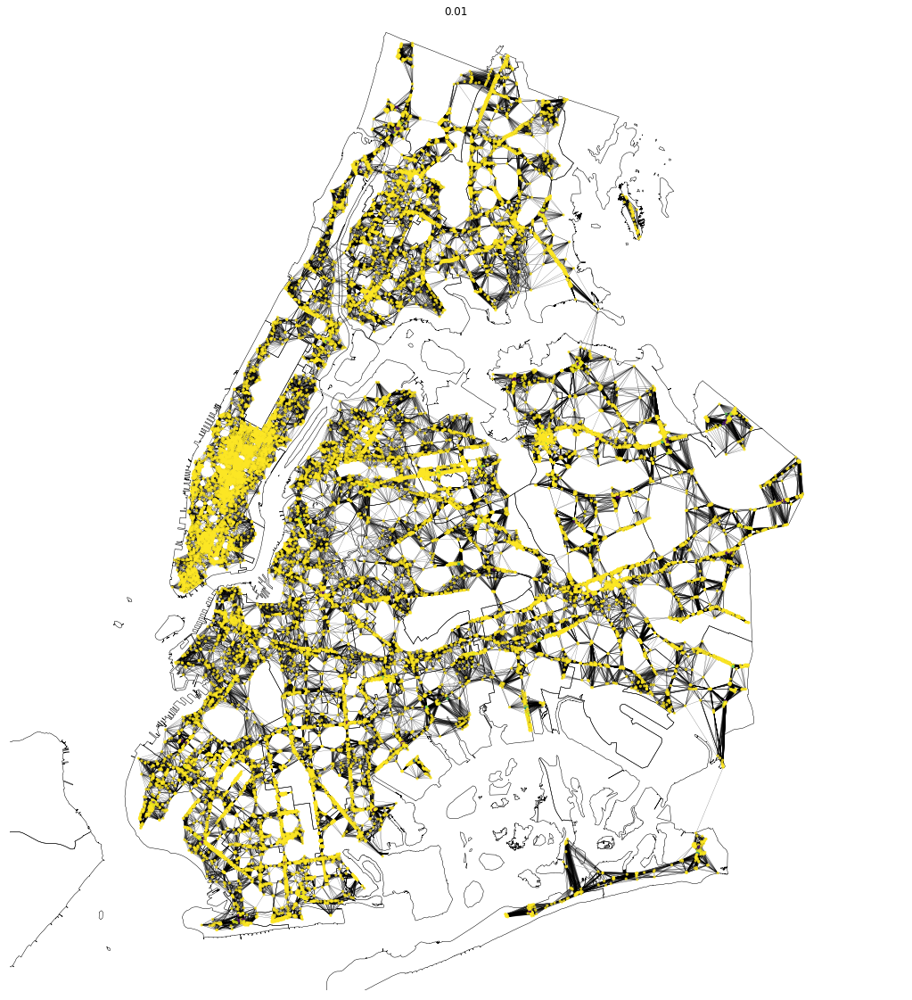

In [43]:
# cut_weighted_hks_dict = {}
# cut_weighted_hks_dict[1e-2] = {k: v for k, v in weighted_hks_dict[1e-2].items() if v < 1e-15}
# cut_weighted_G = weighted_G.subgraph(cut_weighted_hks_dict[1e-2].keys())
compare_to_node_s(unweighted_G, positions, unweighted_hks_dict, 26, ts=[1e-2])

0.0 0.009158140051919055 0.5807221059399054
0.0 0.007638212416200435 0.4578817717087867

0.0 8.174275956667149e-05 0.006181283014010469
0.0 8.158445120337742e-05 0.006162257246344103

0.0 7.326784010971311e-25 1.3465857239556426e-22
0.0 0.0 0.0

0.0 1.8065742880320266e-112 1.1338795845488912e-109
0.0 0.0 0.0

0.0 1.5032486090819974e-221 1.7154881424874372e-218
0.0 0.0 0.0



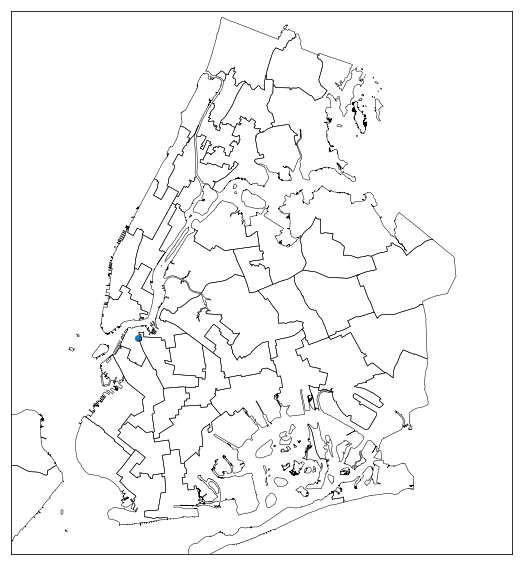

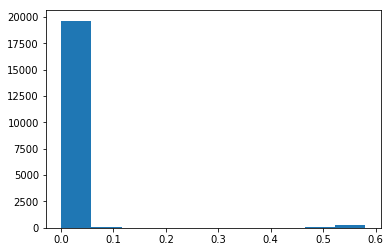

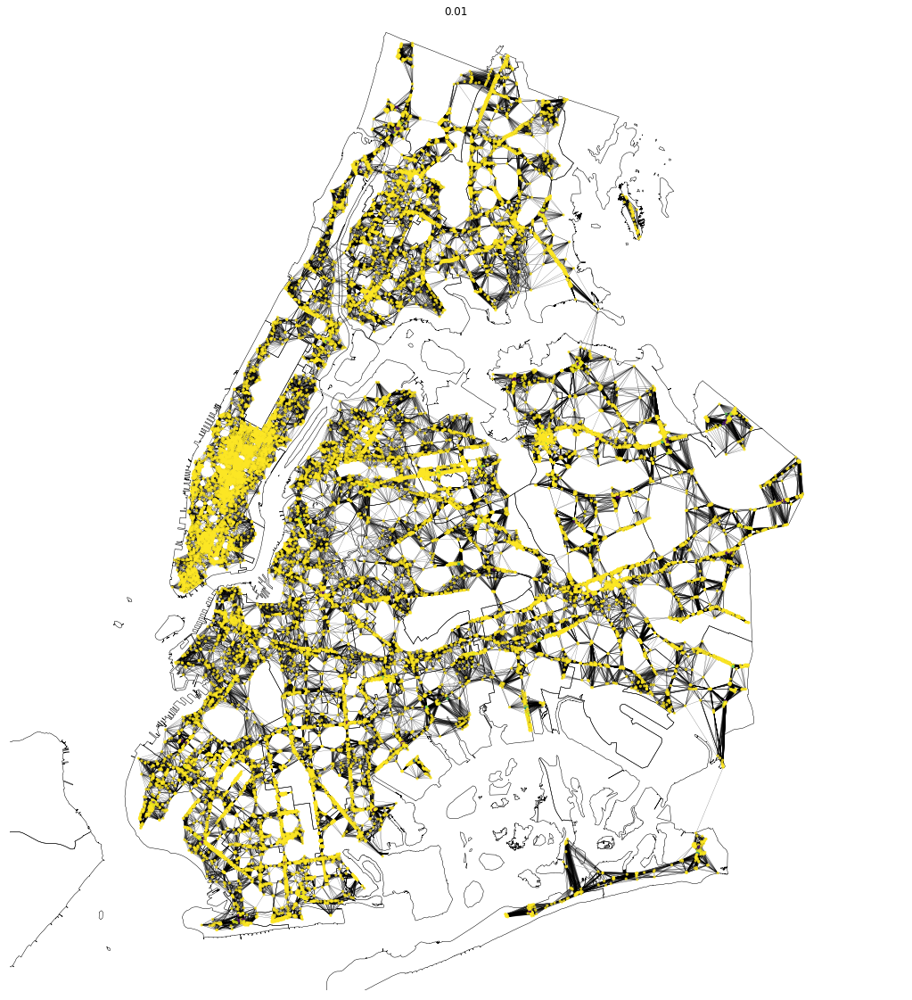

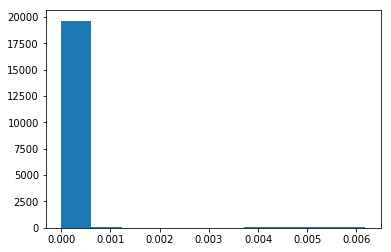

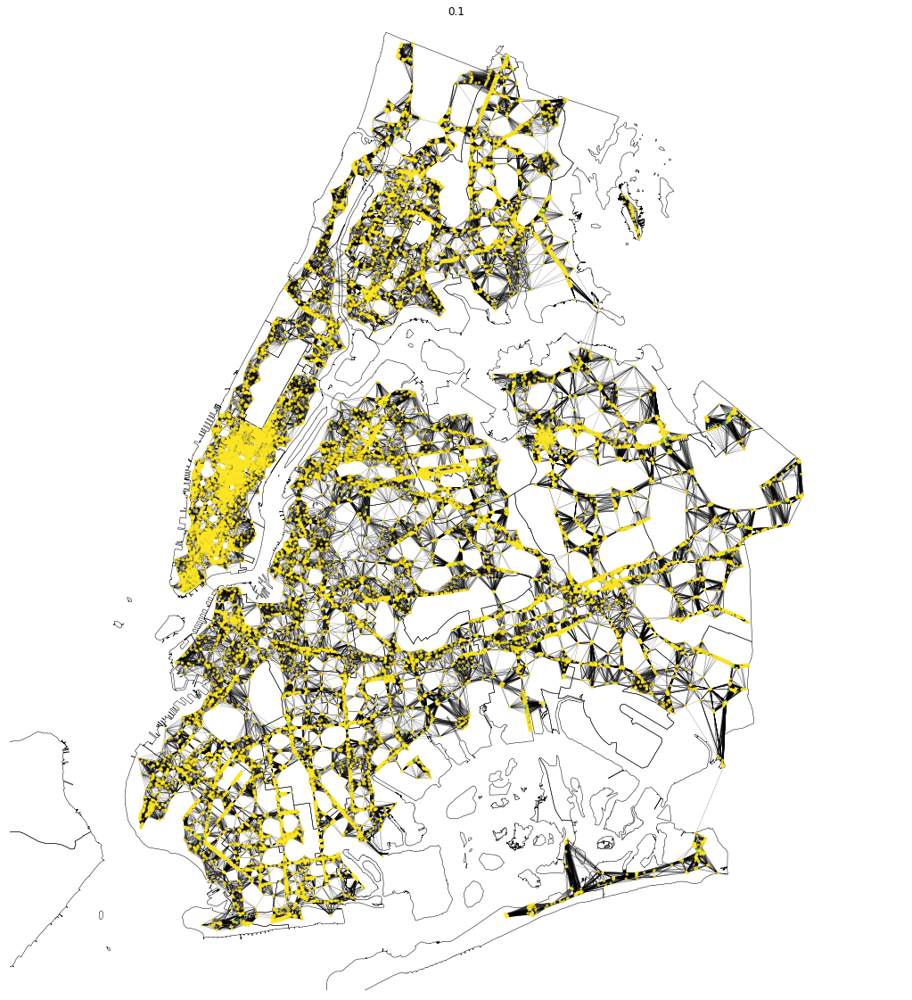

...

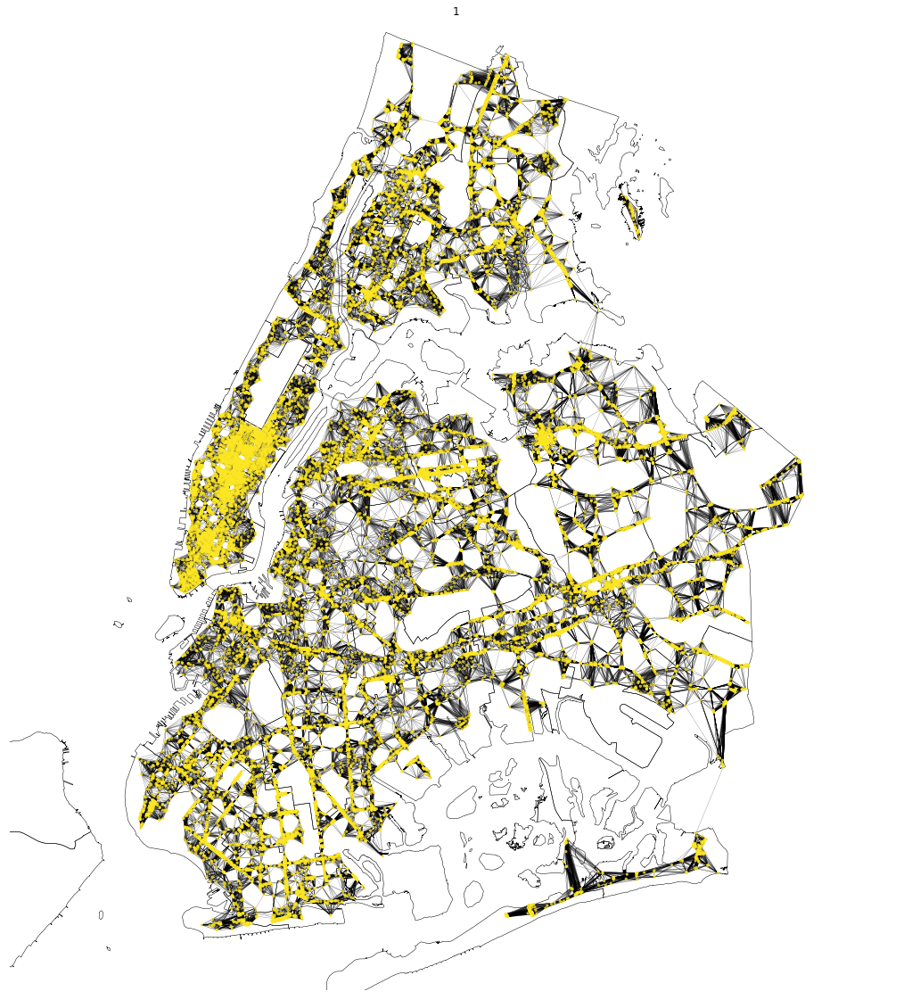

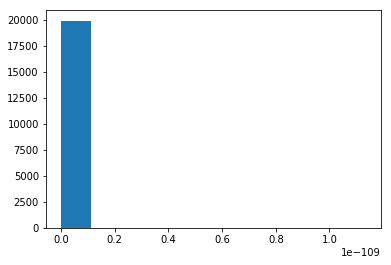

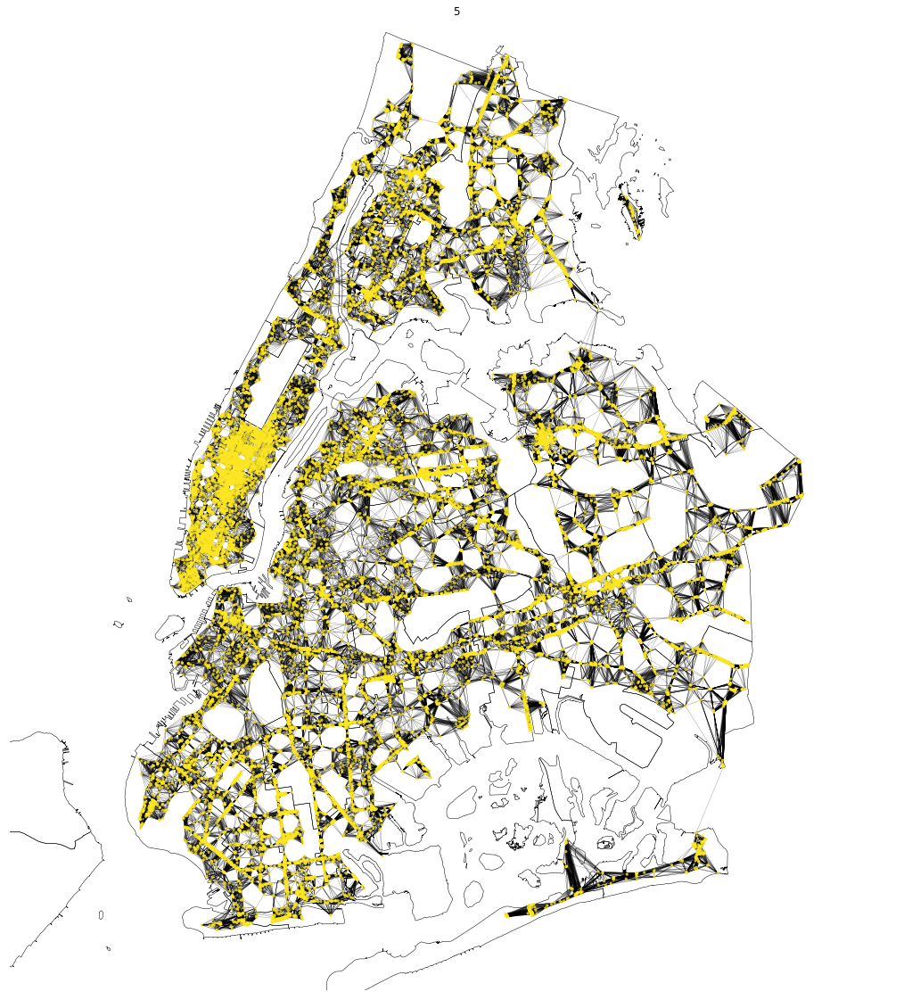

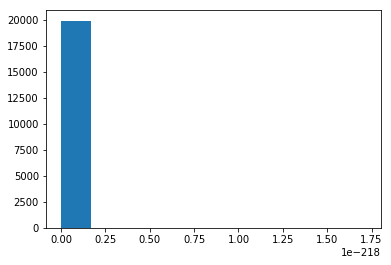

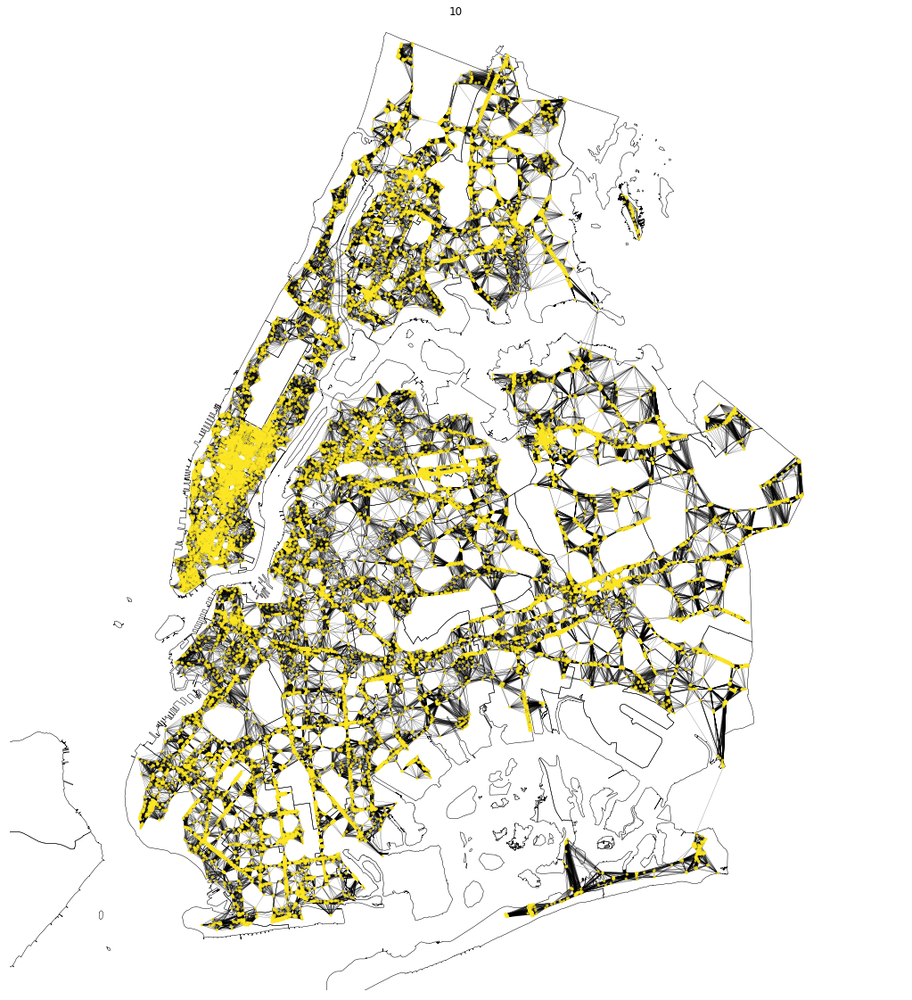

In [44]:
compare_to_node_s(unweighted_G, positions, unweighted_hks_dict, 26, [.01, .1, 1, 5, 10])

In [27]:
positions[26]

(12667.320078510116, 21600.629692765884)

In [ ]:
{i: (pair[2], pair[1]) for i, pair in enumerate(lu5[['lon', 'lat']].itertuples())}[10000]

In [ ]:
compare_to_node_s(unweighted_G, positions, unweighted_hks_dict, 10000)

In [ ]:
plt.scatter(*positions[10])

In [42]:
unweighted_hks_dict[1e-2][26]

0.0006607888100192397